## Part 1A

First the x and y values are read from the 4 data files and stored in an array of tubles (xs, ys)

In [1]:
import urllib2
import csv

def load_file(url):
    # load the url
    file = urllib2.urlopen(url)
    lines = file.readlines();
    # array of x and y values
    xs = []
    ys = []
    
    for line in lines:
        values = line.split("\t")
        # add x and y value to the arrays
        xs.append(float(values[0]));
        ys.append(float(values[1]));
        
    # return a tuple containing the x and y values
    return (xs, ys)

# load the values of all 4 data files
dataFiles = []
dataFiles.append(load_file('https://dl.dropboxusercontent.com/u/153071/teaching/02806_2016/data1.tsv'))
dataFiles.append(load_file('https://dl.dropboxusercontent.com/u/153071/teaching/02806_2016/data2.tsv'))
dataFiles.append(load_file('https://dl.dropboxusercontent.com/u/153071/teaching/02806_2016/data3.tsv'))
dataFiles.append(load_file('https://dl.dropboxusercontent.com/u/153071/teaching/02806_2016/data4.tsv'))

Then the **mean** is calculated and printed in two decimal precision.

In [2]:
import numpy as np

# returns the mean of a datafile
def mean(dataFile):
    mx = np.mean(dataFile[0])
    my = np.mean(dataFile[1])
    return (mx, my)

# print the means of each data set in 2 decimal places
for i in range(4):
    mx, my = mean(dataFiles[i])
    print "The means of dataset {0}:".format(i+1)
    print "x = %s" % "{:4.2f}".format(mx)
    print "y = %s" % "{:4.2f}".format(my)

The means of dataset 1:
x = 9.00
y = 7.50
The means of dataset 2:
x = 9.00
y = 7.50
The means of dataset 3:
x = 9.00
y = 7.50
The means of dataset 4:
x = 9.00
y = 7.50


The **variance** is calculated and printed in 3 decimal precision.

In [3]:
# returns the variance of a datafile
def variance(dataFile):
    vx = np.var(dataFile[0])
    vy = np.var(dataFile[1])
    return (vx, vy)

# print the variance of each data set in 3 decimal places
for i in range(4):
    vx, vy = variance(dataFiles[i])
    print "The variance of dataset {0}:".format(i+1)
    print "x = %s" % "{:6.3f}".format(vx)
    print "y = %s" % "{:6.3f}".format(vy)

The variance of dataset 1:
x = 10.000
y =  3.752
The variance of dataset 2:
x = 10.000
y =  3.752
The variance of dataset 3:
x = 10.000
y =  3.748
The variance of dataset 4:
x = 10.000
y =  3.748


Finally, the **Pearson correlation** is calculated and printed in 3 decimal precision.

In [4]:
# returns the correlation of a datafile
def correlation(dataFile):
    corr = np.corrcoef(dataFile)
    return corr[0][1]

# print the correlation of each data set in 3 decimal places
for i in range(4):
    corr = correlation(dataFiles[i])
    print "The correlation of dataset {0}:".format(i+1)
    print "(x, y) = %s" % "{:5.3f}".format(corr)

The correlation of dataset 1:
(x, y) = 0.816
The correlation of dataset 2:
(x, y) = 0.816
The correlation of dataset 3:
(x, y) = 0.816
The correlation of dataset 4:
(x, y) = 0.817


Here **linear regression** is used on the 4 data sets in order to determine a and b in 2 decimal precision.

In [5]:
from scipy import stats

# returns a and b of a linear regression
def linear_reg(dataFile):
    slope, intercept, r_value, p_value, std_err = stats.linregress(dataFile)
    return (slope, intercept)

# print a and b in 3 decimal places
for i in range(4):
    a, b = linear_reg(dataFiles[i])
    print "The linear regression of dataset {0}:".format(i+1)
    print "a = %s" % "{:4.2f}".format(a)
    print "b = %s" % "{:4.2f}".format(b)

The linear regression of dataset 1:
a = 0.50
b = 3.00
The linear regression of dataset 2:
a = 0.50
b = 3.00
The linear regression of dataset 3:
a = 0.50
b = 3.00
The linear regression of dataset 4:
a = 0.50
b = 3.00


The 4 data sets can be seen **plotted** below.

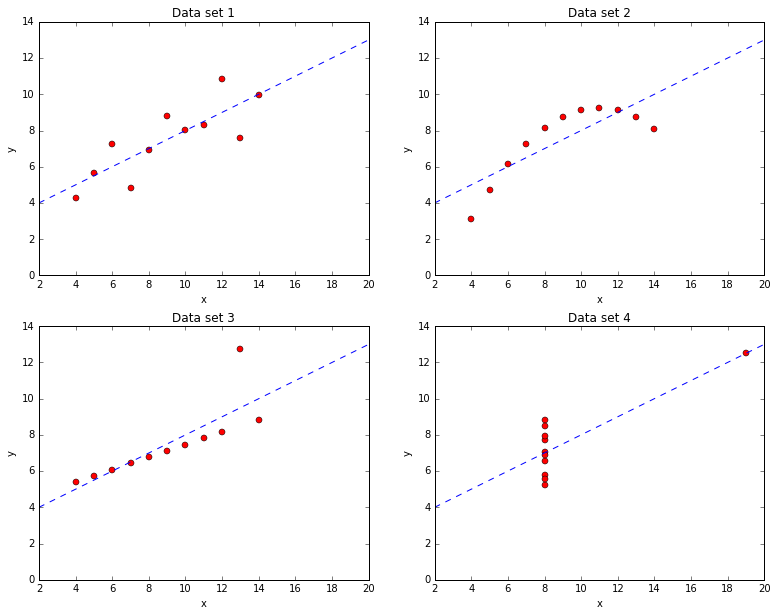

In [6]:
%matplotlib inline
import matplotlib.pyplot as plt

def plot_data(dataFile, plotNumber):
    # determine line
    a, b = linear_reg(dataFile)
    line = [2 * a + b, 20 * a + b]
    xs, ys = dataFile
    
    # create plot
    plt.subplot(2, 2, plotNumber)
    plt.title("Data set {0}".format(plotNumber))
    plt.axis([2, 20, 0, 14])
    plt.xlabel('x')
    plt.ylabel('y')
    # plot the dots
    plt.plot(xs, ys, 'ro')
    # plot the line
    plt.plot([2, 20], line, 'b--')

# create the plot
plt.figure(figsize=(13,10))
plot_data(dataFiles[0], 1)
plot_data(dataFiles[1], 2)
plot_data(dataFiles[2], 3)
plot_data(dataFiles[3], 4)
plt.show();

**Point of exercise** 

A major part of data science is to communicate the data and results, mainly by using various diagrams and plots. A lot of tweaking of the plots is often needed in order for the plots to look good and present the data in the best possible way to the reader. Learning how to use plots and how to present your data is therefore an essential step to become a data scientist.

# Part 1B
Below is a list of San Francisco's police districts:

In [7]:
from csv import reader  

# returns a list of police districts
def districts():
    # the data set
    dataFile = open("SFPD_Incidents.csv", 'r')
    districts = set()
    
    for line in reader(dataFile):
        district = line[6]
        # skip first line and non-existing values
        if district == "PdDistrict" or district == "":
            continue
        # add district to the set
        districts.add(district)
    
    return list(districts)
    
# print the districts
policeDistricts = districts()
print "San Francisco police districts:"
print policeDistricts

San Francisco police districts:
['CENTRAL', 'NORTHERN', 'INGLESIDE', 'SOUTHERN', 'MISSION', 'TENDERLOIN', 'RICHMOND', 'TARAVAL', 'BAYVIEW', 'PARK']


The **distribution of total crimes and focus crimes** across all police districs can be seen below. It clearly shows that both the highest number of crimes and focus crimes takes place in **Southern** police district. 

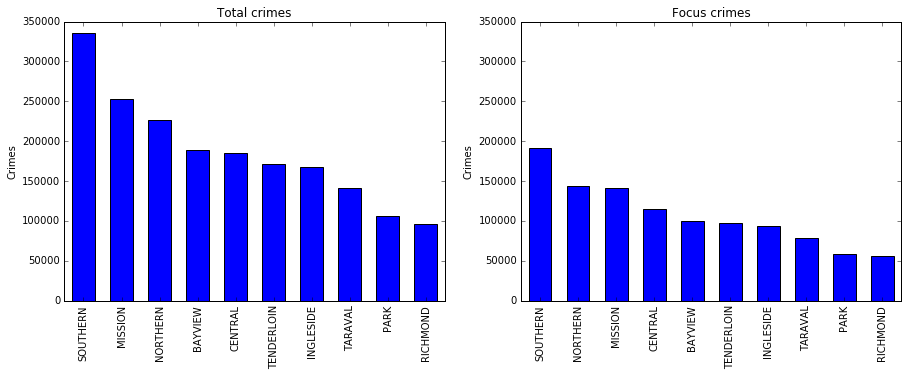

In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
from collections import Counter

# focus crimes
focuscrimes = set(['WEAPON LAWS', 'PROSTITUTION', 'DRIVING UNDER THE INFLUENCE', 
                   'ROBBERY', 'BURGLARY', 'ASSAULT', 'DRUNKENNESS', 'DRUG/NARCOTIC', 
                   'TRESPASS', 'LARCENY/THEFT', 'VANDALISM', 'VEHICLE THEFT', 
                   'STOLEN PROPERTY', 'DISORDERLY CONDUCT'])

# returns a histogram of crimes per district
def crimes_per_district(onlyFocusCrimes):
    # the data set
    dataFile = open("SFPD_Incidents.csv", 'r') 
    histogram = Counter()
    
    for line in reader(dataFile):
        district = line[6];
        crime = line[1]
        # skip first line and non-existing values
        if district == "PdDistrict" or district == "":
            continue;
        if (not onlyFocusCrimes or crime in focuscrimes):
            histogram[district] += 1;
        
    return histogram.most_common()


plt.figure(figsize=(15,5))
# plot the data of all crimes
histogram = crimes_per_district(False)
size = len(histogram)
xs = [x[0] for x in histogram]
ys = [x[1] for x in histogram]
plt.subplot(1, 2, 1)
plt.axis([-0.5, 9.5, 0, 350000])
plt.bar([x - 0.3 for x in range(size)], ys, 0.6)
plt.xticks(range(size), xs, rotation='90', verticalalignment='top', fontsize = 10) 
plt.ylabel("Crimes")
plt.title("Total crimes")

# plot the data of focus crimes
histogram = crimes_per_district(True)
size = len(histogram)
xs = [x[0] for x in histogram]
ys = [x[1] for x in histogram]
plt.subplot(1, 2, 2)
plt.axis([-0.5, 9.5, 0, 350000])
plt.bar([x - 0.3 for x in range(size)], ys, 0.6)
plt.xticks(range(size), xs, rotation='90', verticalalignment='top', fontsize = 10) 
plt.ylabel("Crimes")
plt.title("Focus crimes")

plt.show()

In order to determine a **probability of a crime in a district**, we store all crimes in a histogram for each district. We also keep a histogram for all districts.

In [9]:
# returns the distribution of crimes per category
def crime_probabilities():
     # the data set
    dataFile = open("SFPD_Incidents.csv", 'r')
    # create dictionary of histograms (one per district and one for all)
    histograms = {"ALL": Counter()}
    for x in policeDistricts:
        histograms[x] = Counter()
        
    for line in reader(dataFile):
        district = line[6];
        crime = line[1]
        # skip first line and non-existing values
        if district == "PdDistrict" or district == "":
            continue;
        histograms[district][crime] += 1;
        histograms["ALL"][crime] += 1;
    
    return histograms

histograms = crime_probabilities()

We then normalize the data to get it between 0 and 1.

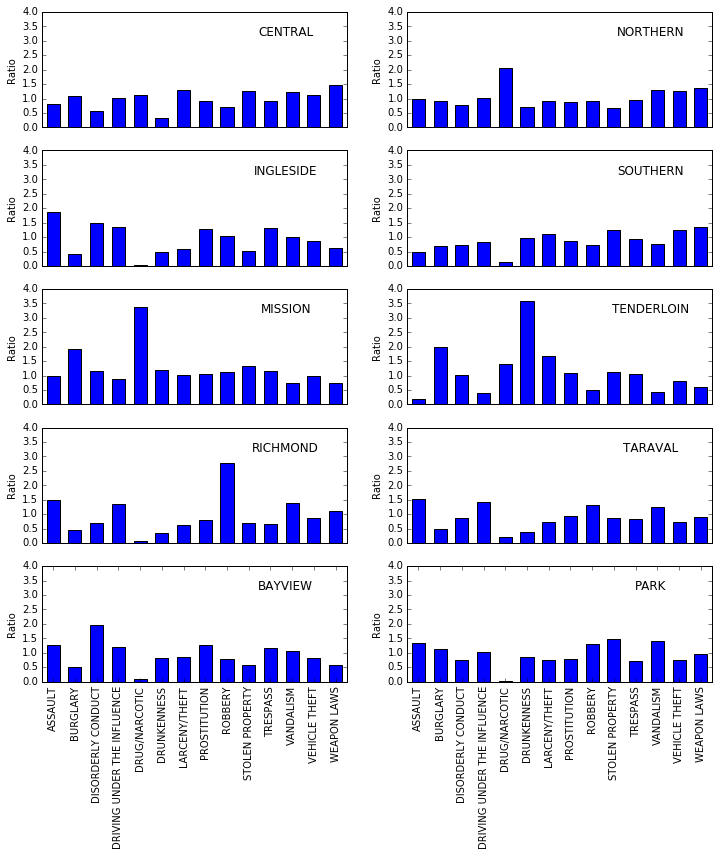

In [10]:
# normalize the values of the histogram
def normalize(histogram):
    total = float(sum(histogram.values()))
    normalized = {}
    for key in histogram.keys():
        normalized[key] = histogram[key] / total
        
    return normalized;

# the probability of a type of crime
def p(crime):
    histogram = normalize(histograms["ALL"])
    return histogram[crime]

# the probability of a type of crime within a district
def p_district(crime, district):
    histogram = normalize(histograms[district])
    return histogram[crime]

def ratio(crime, district):
    return p_district(crime, district) / p(crime)

def plot_district(name, number, showLabels):
    # get data
    xs = list(sorted(focuscrimes))
    ys = [ratio(x, name) for x in focuscrimes]
    
    plt.subplot(5, 2, number)
    plt.axis([-0.5, 13.5, 0, 4])
    plt.bar([x - 0.3 for x in range(len(focuscrimes))], ys, 0.6)
    if showLabels:
        plt.xticks(range(len(focuscrimes)), xs, rotation='90', verticalalignment='top', fontsize = 10)
    else:
        plt.xticks([], [])
    plt.ylabel("Ratio")
    plt.title(name, x=0.8, y=0.75)

def plot_ratios():
    plt.figure(figsize=(12,12))
    plotnumber = 1
    for dis in policeDistricts:
        plot_district(dis, plotnumber, plotnumber > 8)
        plotnumber += 1
    
    plt.show();
    
plot_ratios()

The figures display Tenderloin has a high crime rate of drunk
Tenderloin is downtown in San Fransisco. Wikipedia is referring to this district as a place for lots of crime, and especially drugs are openly being dealt and used on the streets. This corresponds fine with it being the top crime from our data. 

Mission is also downtown, but more low key and less harsh than Tenderloin. Wikipedia doesn’t really say much about the neighborhood in the sense of crime. 

Richmond is described as a more exclusive place in San Fransisco, with people earning more money, less likely to end in poverty and also have a higher rent than most of the other districts. The houses there might be worth more, so it makes sense that there are many robberies in this district.

When calculating the ration one needs to include all data since it otherwise might c

# Part 1C

For this part of the assignment, we should plot the following crime categories on their own map using geoplotlib.kde(): 
* PROSTITUTION 
* DRIVING UNDER THE INFLUENCE 
* DRUG/NARCOTIC

First, we define a function *crime_heatmap()* to read the data, as well as an *isValid()* function, since the weekly exercises showed that a few data entries were very far from San Fransisco. Both can be found below:

In [1]:
import geoplotlib
from geoplotlib.utils import read_csv, BoundingBox
from csv import reader 

def isValid(x,y):
    if x > -122.5 and x < -122.0 and y < 38.0 and y > 37.5:
        return True
    else:
        return False

def crime_heatmap(crime, x, y):
    lines = 0
    # the data set
    dataFile = open("SFPD_Incidents.csv", 'r') 
    
    for line in reader(dataFile):
        if line[9] == 'X':
            continue
    
        if crime != line[1]:
            continue
        
        _x = float(line[9])
        _y = float(line[10])
        lines += 1

        if lines > 1300000:
            continue
        elif isValid(_x,_y):
            x.append(_x)
            y.append(_y)
        else:
            continue

def findBoundingbox(x,y):
    west = min(x[:])-0.01
    east = max(x[:])+0.01
    north = min(y[:])-0.01
    south = max(y[:])+0.01
    
    boundingbox = BoundingBox(north=north, west=west, south=south, east=east)
    
    return boundingbox

### Plotting the 'Prostitution - heatmap'
The first heatmap is to show only the crime category **Prostitution**:

In [4]:
pros_x = []
pros_y = []

print 'PROSTITUTION - geoplot.kde()'
crime_heatmap('PROSTITUTION', pros_x, pros_y)
geo_data_for_plotting = {"lat": [float(d) for d in pros_y], "lon": [float(d) for d in pros_x]}

geoplotlib.kde(geo_data_for_plotting, bw=3)
geoplotlib.set_bbox(findBoundingbox(pros_x,pros_y))
geoplotlib.inline()

PROSTITUTION - geoplot.kde()
('smallest non-zero count', 1.9901719039787654e-09)
('max count:', 21.749089774128471)


### Plotting the 'Driving under the influence - heatmap'
The second heatmap is to show only the crime category **Driving under the influence**:

In [3]:
driv_x = []
driv_y = []

print 'DRIVING UNDER THE INFLUENCE - geoplot.kde()'
crime_heatmap('DRIVING UNDER THE INFLUENCE', driv_x, driv_y)
geo_data_for_plotting = {"lat": [float(d) for d in driv_y], "lon": [float(d) for d in driv_x]}
geoplotlib.kde(geo_data_for_plotting, bw=3)
geoplotlib.set_bbox(findBoundingbox(driv_x,driv_y))
geoplotlib.inline()

DRIVING UNDER THE INFLUENCE - geoplot.kde()
('smallest non-zero count', 1.9901719039787654e-09)
('max count:', 1.6100048924774493)


### Plotting the 'Drug/Narcotic - heatmap'
The final heatmap is to show only the crime category **Drug/Narcotic**:

In [14]:
drug_x = []
drug_y = []

print 'DRUG/NARCOTIC - geoplot.kde()'
crime_heatmap('DRUG/NARCOTIC', drug_x, drug_y)
geo_data_for_plotting = {"lat": [float(d) for d in drug_y], "lon": [float(d) for d in drug_x]}
geoplotlib.kde(geo_data_for_plotting, bw=3)
geoplotlib.set_bbox(findBoundingbox(drug_x,drug_y))
geoplotlib.inline()

DRUG/NARCOTIC - geoplot.kde()
('smallest non-zero count', 1.9901719039787654e-09)
('max count:', 71.1044427220655)


A very important thing to mention here is the **max count** which is shown above each heatmap. First glance over the heatmaps might indicate that there are most driving arrests since theres way more *'heated'* values on the map. The thing is, the most heated values are the **max count**, and since the driving heatmap has a max count of **~1.61** and drug has **~71.10**, even the least heated values on the drug heatmap might be way more frequent than the amount of driving arrests.

The next part consists of loading the actual data into the model. For this, we used the *scikit-learn's KNeighborsClassifier*. Initially, the function for loading the data correctly is define using the *isValid()*:

In [15]:
from csv import reader 
import numpy as np
import pylab as pl
from sklearn import neighbors, datasets

focuscrimes = set(['PROSTITUTION', 'DRIVING UNDER THE INFLUENCE', 'DRUG/NARCOTIC'])

def readData(x, y):
    lines = 0
    # the data set
    dataFile = open("SFPD_Incidents.csv", 'r') 
    
    for line in reader(dataFile):
        if line[9] == 'X':
            continue
    
        if not line[1] in focuscrimes:
            continue
        
        crimeNum = 0
        if line[1] == 'DRIVING UNDER THE INFLUENCE':
            crimeNum = 1
        elif line[1] == 'DRUG/NARCOTIC':
            crimeNum = 2
        
        coorX = float(line[9])
        coorY = float(line[10])   
        lines += 1

        if lines > 1300000:
            continue
        elif isValid(coorX,coorY):
            x.append([coorX,coorY])
            y.append(crimeNum)
        else:
            continue

Next, we load it into the model using the defined function, and initializing the *KNeighborsClassifier*, and fit the data into it:

In [16]:
%matplotlib inline
from csv import reader 
import numpy as np
import pylab as pl
from sklearn import neighbors, datasets

x = []
y = []

readData(x, y)

ndarrayX = np.array(x)
ndarrayY = np.array(y)

knn = neighbors.KNeighborsClassifier()
knn.fit(ndarrayX, ndarrayY)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=5, p=2,
           weights='uniform')

Then we can plot the data using the KNN model:

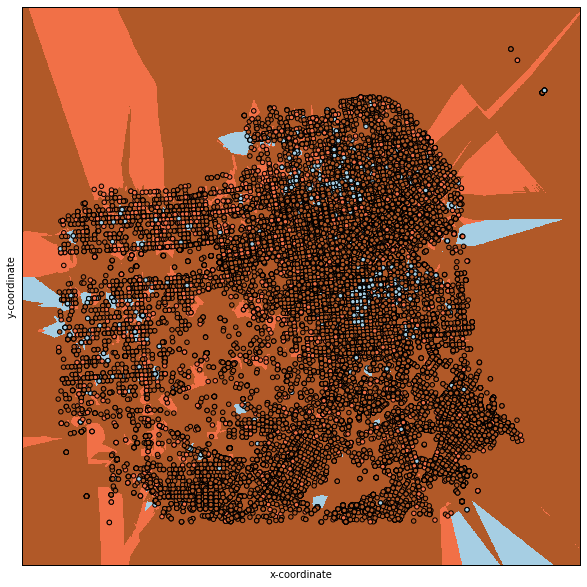

In [17]:
h = .0001

# Plot the decision boundary. For that, we will asign a color to each
# point in the mesh [x_min, m_max]x[y_min, y_max].
x_min, x_max = ndarrayX[:,0].min() - .01, ndarrayX[:,0].max() + .01
y_min, y_max = ndarrayX[:,1].min() - .01, ndarrayX[:,1].max() + .01
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
pl.figure(1, figsize=(10, 10))
pl.set_cmap(pl.cm.Paired)
pl.pcolormesh(xx, yy, Z)

# Plot also the training points
pl.scatter(ndarrayX[:,0], ndarrayX[:,1],c=ndarrayY )
pl.xlabel('x-coordinate')
pl.ylabel('y-coordinate')

pl.xlim(xx.min(), xx.max())
pl.ylim(yy.min(), yy.max())
pl.xticks(())
pl.yticks(())
pl.show()

The interesting thing here, is the fact that theres still many more occurences of drug arrests, and many entries at similar places. This creates a clear imbalance. The amount of occurences for each can be seen below:

In [18]:
amount_pros = 0
amount_driv = 0
amount_drug = 0

dataFile = open("SFPD_Incidents.csv", 'r') 
    
for line in reader(dataFile):
    if line[1] == 'PROSTITUTION':
        amount_pros += 1

    if line[1] == 'DRIVING UNDER THE INFLUENCE':
        amount_driv += 1
    
    if line[1] == 'DRUG/NARCOTIC':
        amount_drug += 1
    

print 'Amount of arrests with category PROSTITUTION: ', amount_pros
print 'Amount of arrests with category DRIVING UNDER THE INFLUENCE: ', amount_driv
print 'Amount of arrests with category DRUG/NARCOTIC: ', amount_drug

Amount of arrests with category PROSTITUTION:  15563
Amount of arrests with category DRIVING UNDER THE INFLUENCE:  4918
Amount of arrests with category DRUG/NARCOTIC:  110953


When there are that many more entries with drug arrests, the possibility of predicting drug arrests would be much higher. This makes it less clear as a map, as the drug arrests will end up being very dominant on the map. 
If it were more balanced, the same tendencies as seen in the heat maps, should also be visible in the KNN map.

We continue with the full data set for this part of the assignment.

Next up, we need to create a map of dots, that should then be colored depending on the KNN. Please note that the values for the boundingbox are now hardcoded, because the function caused problems for this part:

In [19]:
import geoplotlib
from geoplotlib.utils import read_csv, BoundingBox
from csv import reader 

alldata_x = pros_x+driv_x+drug_x
alldata_y = pros_y+driv_y+drug_y

gridSize = 100
boundingbox = BoundingBox(north=37.8299754923, west=-122.509928313, south=37.6981535998, east=-122.354937494)

y_steps = abs((boundingbox.north - boundingbox.south)) / gridSize
x_steps = abs((boundingbox.west - boundingbox.east)) / gridSize

x_list = []
y_list = []

for x in range(gridSize):
    for y in range(gridSize):
        x_list.append(boundingbox.west + (x * x_steps))
        y_list.append(boundingbox.north - (y * y_steps))

geo_data_for_plotting = {"lat": [float(d) for d in y_list], "lon": [float(d) for d in x_list]}
geoplotlib.dot(geo_data_for_plotting, color='red')
geoplotlib.set_bbox(boundingbox)
geoplotlib.inline()

Now, the KNN model is used to predict which category is most likely to find, based on the position of the dot. The first map of dots are using KNN looking at 5 neighbors:

In [20]:
import geoplotlib
from geoplotlib.utils import read_csv, BoundingBox
from csv import reader 
import numpy as np
from sklearn import neighbors, datasets
from sklearn.neighbors import KNeighborsClassifier

x_list_pros = []
y_list_pros = []
x_list_driv = []
y_list_driv = []
x_list_drug = []
y_list_drug = []

knn5 = neighbors.KNeighborsClassifier(5)
knn5.fit(ndarrayX,ndarrayY)

for x in range(100):
    for y in range(100):
        x_value = boundingbox.west + (x * x_steps)
        y_value = boundingbox.north - (y * y_steps)
        
        search = [[x_value, y_value]]
        
        color = knn.predict(search)
        
        if color == 0:
            x_list_pros.append(x_value)
            y_list_pros.append(y_value)
        elif color == 1:
            x_list_driv.append(x_value)
            y_list_driv.append(y_value)
        else:
            x_list_drug.append(x_value)
            y_list_drug.append(y_value)

geo_data_for_plotting = {"lat": [float(d) for d in y_list_pros], "lon": [float(d) for d in x_list_pros]}
geoplotlib.dot(geo_data_for_plotting, color='red')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_driv], "lon": [float(d) for d in x_list_driv]}
geoplotlib.dot(geo_data_for_plotting, color='blue')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_drug], "lon": [float(d) for d in x_list_drug]}
geoplotlib.dot(geo_data_for_plotting, color='green')
geoplotlib.set_bbox(boundingbox)
print 'Red dots are showing KNN predicting PROSTITUTION'
print 'Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE'
print 'Green dots are showing KNN predicting DRUG/NARCOTIC'
geoplotlib.inline()

Red dots are showing KNN predicting PROSTITUTION
Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE
Green dots are showing KNN predicting DRUG/NARCOTIC


The second map of dots are using KNN looking at 10 neighbors.

In [21]:
import geoplotlib
from geoplotlib.utils import read_csv, BoundingBox
from csv import reader 
import numpy as np
from sklearn import neighbors, datasets
from sklearn.neighbors import KNeighborsClassifier

x_list_pros = []
y_list_pros = []
x_list_driv = []
y_list_driv = []
x_list_drug = []
y_list_drug = []


knn10 = neighbors.KNeighborsClassifier(10)
knn10.fit(ndarrayX,ndarrayY)

for x in range(100):
    for y in range(100):
        x_value = boundingbox.west + (x * x_steps)
        y_value = boundingbox.north - (y * y_steps)
        
        search = [[x_value, y_value]]
        
        color = knn10.predict(search)
        
        if color == 0:
            x_list_pros.append(x_value)
            y_list_pros.append(y_value)
        elif color == 1:
            x_list_driv.append(x_value)
            y_list_driv.append(y_value)
        else:
            x_list_drug.append(x_value)
            y_list_drug.append(y_value)

geo_data_for_plotting = {"lat": [float(d) for d in y_list_pros], "lon": [float(d) for d in x_list_pros]}
geoplotlib.dot(geo_data_for_plotting, color='red')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_driv], "lon": [float(d) for d in x_list_driv]}
geoplotlib.dot(geo_data_for_plotting, color='blue')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_drug], "lon": [float(d) for d in x_list_drug]}
geoplotlib.dot(geo_data_for_plotting, color='green')
geoplotlib.set_bbox(boundingbox)
print 'Red dots are showing KNN predicting PROSTITUTION'
print 'Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE'
print 'Green dots are showing KNN predicting DRUG/NARCOTIC'
geoplotlib.inline()

Red dots are showing KNN predicting PROSTITUTION
Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE
Green dots are showing KNN predicting DRUG/NARCOTIC


The third map of dots are using KNN looking at 30 neighbors.

In [22]:
import geoplotlib
from geoplotlib.utils import read_csv, BoundingBox
from csv import reader 
import numpy as np
from sklearn import neighbors, datasets
from sklearn.neighbors import KNeighborsClassifier

x_list_pros = []
y_list_pros = []
x_list_driv = []
y_list_driv = []
x_list_drug = []
y_list_drug = []


knn30 = neighbors.KNeighborsClassifier(30)
knn30.fit(ndarrayX,ndarrayY)

for x in range(100):
    for y in range(100):
        x_value = boundingbox.west + (x * x_steps)
        y_value = boundingbox.north - (y * y_steps)
        
        search = [[x_value, y_value]]
        
        color = knn30.predict(search)
        
        if color == 0:
            x_list_pros.append(x_value)
            y_list_pros.append(y_value)
        elif color == 1:
            x_list_driv.append(x_value)
            y_list_driv.append(y_value)
        else:
            x_list_drug.append(x_value)
            y_list_drug.append(y_value)

geo_data_for_plotting = {"lat": [float(d) for d in y_list_pros], "lon": [float(d) for d in x_list_pros]}
geoplotlib.dot(geo_data_for_plotting, color='red')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_driv], "lon": [float(d) for d in x_list_driv]}
geoplotlib.dot(geo_data_for_plotting, color='blue')
geo_data_for_plotting = {"lat": [float(d) for d in y_list_drug], "lon": [float(d) for d in x_list_drug]}
geoplotlib.dot(geo_data_for_plotting, color='green')
geoplotlib.set_bbox(boundingbox)
print 'Red dots are showing KNN predicting PROSTITUTION'
print 'Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE'
print 'Green dots are showing KNN predicting DRUG/NARCOTIC'
geoplotlib.inline()

Red dots are showing KNN predicting PROSTITUTION
Blue dots are showing KNN predicting DRIVING UNDER THE INFLUENCE
Green dots are showing KNN predicting DRUG/NARCOTIC


When the amount of neighbors increase in the KNN model, its clear that the drugs are becoming more and more dominant, and the other crime categories are less prominant. This is once again due to the imbalance in the data, because there are so many occurences of drug crimes, and when the amount of neighbors increase, the chance of finding most occurence of drug crimes are also increasing.

# Part 1D

In order to predict the time of the Red Baron, we first define a couple of useful methods (from the book)

In [23]:
from __future__ import division
import math

def mean(x):
    return sum(x) / len(x)

def de_mean(x):
    # translate x by subtracting its mean (so the result has mean 0)
    x_bar = mean(x)
    return [x_i - x_bar for x_i in x]

def dot(v, w):
    # v_1 * w_1 + ... + v_n * w_n"""
    return sum(v_i * w_i for v_i, w_i in zip(v, w))

def sum_of_squares(v):
    # v_1 * v_1 + ... + v_n * v_n"""
    return dot(v, v)

def variance(x):
    # assumes x has at least two elements
    n = len(x)
    deviations = de_mean(x)
    return sum_of_squares(deviations) / (n - 1)

def standard_deviation(x):
    return math.sqrt(variance(x))

def covariance(x, y):
    n = len(x)
    return dot(de_mean(x), de_mean(y)) / (n - 1)

def correlation(x, y):
    stdev_x = standard_deviation(x)
    stdev_y = standard_deviation(y)
    if stdev_x > 0 and stdev_y > 0:
        return covariance(x, y) / stdev_x / stdev_y
    else:
        return 0 # if no variation, correlation is zero
    
def predict(alpha, beta, x_i):
    return beta * x_i + alpha

def error(alpha, beta, x_i, y_i):
    return y_i - predict(alpha, beta, x_i)

def sum_of_squared_errors(alpha, beta, x, y):
    return sum(error(alpha, beta, x_i, y_i) ** 2
        for x_i, y_i in zip(x, y))

def total_sum_of_squares(y):
    # the total squared variation of y_i's from their mean
    return sum(v ** 2 for v in de_mean(y))

def r_squared(alpha, beta, x, y):
    return 1.0 - (sum_of_squared_errors(alpha, beta, x, y) /
         total_sum_of_squares(y))

def least_squares_fit(x, y):
    # given training values for x and y,
    # find the least-squares values of alpha and beta
    beta = correlation(x, y) * standard_deviation(y) / standard_deviation(x)
    alpha = mean(y) - beta * mean(x)
    return alpha, beta

We create a training set and a test from the data we have a bout the Red Baron. We then use **linear regression** on the training data and use the test data to determine the goodness of our fit.

In [24]:
import urllib2
from csv import reader
import random
 
# load the data set using the method from part 1A
xFiles = urllib2.urlopen('https://raw.githubusercontent.com/suneman/socialdataanalysis2016/master/files/x-files.csv')

# scales a time between 0 and 1
def scale_time(time):
    splitted = time.split(':')
    hours = int(splitted[0])
    minutes = int(splitted[1])
    return (60 * hours + minutes) / float(24 * 60)

# scales a week day between 0 and 1
def scale_weekday(weekday):
    # map a weekday to a number 0-6 (sunday-saturday) 
    dayNumbers = {'Monday': 0, 'Tuesday': 1, 'Wednesday': 2,
                 'Thursday': 3, 'Friday': 4, 'Saturday': 5, 'Sunday': 6, }
    return dayNumbers[weekday] / 6.0

# returns a training and test set containing scaled week days and times
def prediction_data1():
    training = ([], [])
    test = ([], [])
    random.seed(0)
    
    for line in reader(xFiles):
        # only take data with red baron
        if line[7] == 'RED BARON':
            x = scale_weekday(line[3])
            y = scale_time(line[5])
            # randomly put it in test or training data
            if random.randint(1, 5) == 1:
                test[0].append(x)
                test[1].append(y)
            else:
                training[0].append(x)
                training[1].append(y)
                
    return (training, test)

# create training and test data
training, test = prediction_data1()
# use linear regression on training set
alpha, beta = least_squares_fit(training[0], training[1])
# determine the goodness of the fit from the test set
r2_1 = r_squared(alpha, beta, test[0], test[1])
print "Goodness of fit: {0}".format(r2_1)

Goodness of fit: 0.74615259152


Additionally, we also plot the Red Baron data and our prediction (blue line)

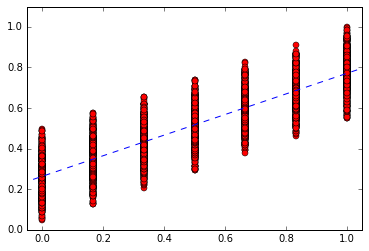

In [25]:
%matplotlib inline
import matplotlib.pyplot as plt

# create plot
plt.axis([-0.05, 1.05, 0, 1.1])
# plot the dots
plt.plot(training[0], training[1], 'ro')
# plot the line
plt.plot([-1, 2], [predict(alpha, beta, -1), predict(alpha, beta, 2)], 'b--')
plt.show();

In order to take multiple inputs we add a few more handy functions (from the book)

In [26]:
def vector_subtract(v, w):
    # subtracts corresponding elements
    return [v_i - w_i for v_i, w_i in zip(v, w)]

def scalar_multiply(c, v):
    # c is a number, v is a vector
    return [c * v_i for v_i in v]

def in_random_order(data):
    # generator that returns the elements of data in random order
    indexes = [i for i, _ in enumerate(data)] # create a list of indexes
    random.shuffle(indexes) # shuffle them
    for i in indexes: # return the data in that order
        yield data[i]


def minimize_stochastic(target_fn, gradient_fn, x, y, theta_0, alpha_0=0.01):
    data = zip(x, y)
    theta = theta_0 # initial guess
    alpha = alpha_0 # initial step size
    min_theta, min_value = None, float("inf") # the minimum so far
    iterations_with_no_improvement = 0
    
    # if we ever go 100 iterations with no improvement, stop
    while iterations_with_no_improvement < 100:
        value = sum( target_fn(x_i, y_i, theta) for x_i, y_i in data )
        
        if value < min_value:
            # if we've found a new minimum, remember it
            # and go back to the original step size
            min_theta, min_value = theta, value
            iterations_with_no_improvement = 0
            alpha = alpha_0
        else:
            # otherwise we're not improving, so try shrinking the step size
            iterations_with_no_improvement += 1
            alpha *= 0.9
 
        # and take a gradient step for each of the data points
        for x_i, y_i in in_random_order(data):
            gradient_i = gradient_fn(x_i, y_i, theta)
            theta = vector_subtract(theta, scalar_multiply(alpha, gradient_i))
    
    return min_theta

def predict(x_i, beta):
    return dot(x_i, beta)

def error(x_i, y_i, beta):
    return y_i - predict(x_i, beta)

def squared_error(x_i, y_i, beta):
    return error(x_i, y_i, beta) ** 2

def squared_error_gradient(x_i, y_i, beta):
    return [-2 * x_ij * error(x_i, y_i, beta) for x_ij in x_i]

def estimate_beta(x, y):
    beta_initial = [random.random() for x_i in x[0]]
    return minimize_stochastic(squared_error,
        squared_error_gradient, x, y, beta_initial, 0.001)

def multiple_r_squared(x, y, beta):
    sum_of_squared_errors = sum(error(x_i, y_i, beta) ** 2
        for x_i, y_i in zip(x, y))
    return 1.0 - sum_of_squared_errors / total_sum_of_squares(y)

We then do the same thing as before but this time with also use **year** as input. The new model has a goodness of ~0.793, almost 0.05 higher than before. 

In [27]:
# load the data set using the method from part 1A
xFiles = urllib2.urlopen('https://raw.githubusercontent.com/suneman/socialdataanalysis2016/master/files/x-files.csv')

# scale the year between 0-1 (2003-2016)
def scale_year(date):
    year = int(date.split('/')[2])
    return (year - 2003) / 13.0

# returns a training and test set containing scaled week days, years and times
def prediction_data2():
    training = ([], [])
    test = ([], [])
    random.seed(0)
    
    for line in reader(xFiles):
        # only take data with red baron
        if line[7] == 'RED BARON':
            weekday = scale_weekday(line[3])
            year = scale_year(line[4])
            y = scale_time(line[5])
            # randomly put it in test or training data
            if random.randint(1, 5) == 1:
                test[0].append([1, weekday, year])
                test[1].append(y)
            else:
                training[0].append([1, weekday, year])
                training[1].append(y)
                
    return (training, test)

# create training and test data
training, test = prediction_data2()
# determine beta values for training set
beta = estimate_beta(training[0], training[1])
# determine the goodness of the fit from the test set
r2_2 = multiple_r_squared(test[0], test[1], beta)
print "Goodness of fit: {0}".format(r2_2)
print "An increase of {0}".format(r2_2 - r2_1)

Goodness of fit: 0.793039655736
An increase of 0.0468870642155


Now we add the **longitude** as input this gives a very nice goodness of ~0.988.

In [30]:
# load the data set using the method from part 1A
xFiles = urllib2.urlopen('https://raw.githubusercontent.com/suneman/socialdataanalysis2016/master/files/x-files.csv')

# scale the longitude between 0-1 (-122 to -123)
def scale_longitude(longitude):
    return float(longitude) - (-122.0)

# returns a training and test set containing scaled week days, years and times
def prediction_data3():
    training = ([], [])
    test = ([], [])
    random.seed(0)
    
    for line in reader(xFiles):
        # only take data with red baron
        if line[7] == 'RED BARON':
            weekday = scale_weekday(line[3])
            year = scale_year(line[4])
            longitude = scale_longitude(line[9])
            y = scale_time(line[5])
            
            # randomly put it in test or training data
            if random.randint(1, 5) == 1:
                test[0].append([1, weekday, year, longitude])
                test[1].append(y)
            else:
                training[0].append([1, weekday, year, longitude])
                training[1].append(y)
                
    return (training, test)

# create training and test data
training, test = prediction_data3()
# determine beta values for training set
beta = estimate_beta(training[0], training[1])
# determine the goodness of the fit from the test set
r2_3 = multiple_r_squared(test[0], test[1], beta)
print "Goodness of fit: {0}".format(r2_3)
print "An increase of {0}".format(r2_3 - r2_2)

Goodness of fit: 0.988144255603
An increase of 0.195104599867


Finally, we add **latitude**. This however gives almost the same result but uses way more time finding it. The result is actually slightly worse. This suggests that the latitude input was an irrelevant input for the model.

In [ ]:
# load the data set using the method from part 1A
xFiles = urllib2.urlopen('https://raw.githubusercontent.com/suneman/socialdataanalysis2016/master/files/x-files.csv')

# scale the latitude between 0-1 (37 to 38)
def scale_latitude(latitude):
    return float(latitude) - (37.0)

# returns a training and test set containing scaled week days, years and times
def prediction_data3():
    training = ([], [])
    test = ([], [])
    random.seed(0)
    
    for line in reader(xFiles):
        # only take data with red baron
        if line[7] == 'RED BARON':
            weekday = scale_weekday(line[3])
            year = scale_year(line[4])
            longitude = scale_longitude(line[9])
            latitude = scale_latitude(line[10])
            y = scale_time(line[5])
            
            # randomly put it in test or training data
            if random.randint(1, 5) == 1:
                test[0].append([1, weekday, year, longitude, latitude])
                test[1].append(y)
            else:
                training[0].append([1, weekday, year, longitude, latitude])
                training[1].append(y)
                
    return (training, test)

# create training and test data
training, test = prediction_data3()
# determine beta values for training set
beta = estimate_beta(training[0], training[1])
# determine the goodness of the fit from the test set
r2_4 = multiple_r_squared(test[0], test[1], beta)
print "Goodness of fit: {0}".format(r2_4)
print "An decrease of {0}".format(r2_3 - r2_4)

The beta values also shows that the latitude value (last one) is almost 0 which shows that it is completely irrelevant 

In [ ]:
print beta